In [1]:
# Common
import os
import cv2 as cv
import numpy as np
from IPython.display import clear_output as cls

# Data 
from tqdm import tqdm
from glob import glob

# Data Visuaalization
import plotly.express as px
import matplotlib.pyplot as plt

# Model
from tensorflow.keras.models import load_model

In [2]:
# Setting a random
np.random.seed(42)

# Define the image dimensions
IMG_W, IMG_H, IMG_C = (160, 160, 3)

In [4]:
# Number of images available per person
n_images_per_person = [len(os.listdir(root_path + name)) for name in dir_names]
n_images = sum(n_images_per_person)

# Show
print(f"Total Number of Images : {n_images}.")

Total Number of Images : 17534.


In [5]:
# Plot the Distribution of number of images per person.
fig = px.bar(x=person_names, y=n_images_per_person, color=person_names)
fig.update_layout({'title':{'text':"Distribution of number of images per person"}})
fig.show()

In [6]:
# Select all the file paths : 50 images per person.
filepaths = [path  for name in dir_names for path in glob(root_path + name + '/*')[:50]]
np.random.shuffle(filepaths)
print(f"Total number of images to be loaded : {len(filepaths)}")

# Create space for the images
all_images = np.empty(shape=(len(filepaths), IMG_W, IMG_H, IMG_C), dtype = np.float32)
all_labels = np.empty(shape=(len(filepaths), 1), dtype = np.int32)

# For each path, load the image and apply some preprocessing.
for index, path in tqdm(enumerate(filepaths), desc="Loading Data"):
    
    # Extract label
    label = [name[5:] for name in dir_names if name in path][0]
    label = person_names.index(label.title())
    
    # Load the Image
    image = plt.imread(path)
    
    # Resize the image
    image = cv.resize(image, dsize = (IMG_W, IMG_H))
    
    # Convert image stype
    image = image.astype(np.float32)/255.0
    
    # Store the image and the label
    all_images[index] = image
    all_labels[index] = label

Total number of images to be loaded : 5250


Loading Data: 5250it [00:48, 108.40it/s]


In [7]:
def show_data(
    images: np.ndarray, 
    labels: np.ndarray,
    GRID: tuple=(15,6),
    FIGSIZE: tuple=(25,50), 
    recog_fn = None,
    database = None
) -> None:
    
    """
    Function to plot a grid of images with their corresponding labels.

    Args:
        images (numpy.ndarray): Array of images to plot.
        labels (numpy.ndarray): Array of corresponding labels for each image.
        GRID (tuple, optional): Tuple with the number of rows and columns of the plot grid. Defaults to (15,6).
        FIGSIZE (tuple, optional): Tuple with the size of the plot figure. Defaults to (30,50).
        recog_fn (function, optional): Function to perform face recognition. Defaults to None.
        database (dictionary, optional): Dictionary with the encoding of the images for face recognition. Defaults to None.

Returns:
        None
    """
    
    # Plotting Configuration
    plt.figure(figsize=FIGSIZE)
    n_rows, n_cols = GRID
    n_images = n_rows * n_cols
    
    # loop over the images and labels
    for index in range(n_images):
        
        # Select image in the corresponding label randomly
        image_index = np.random.randint(len(images))
        image, label = images[image_index], person_names[int(labels[image_index])]
        
        # Create a Subplot
        plt.subplot(n_rows, n_cols, index+1)
        
        # Plot Image
        plt.imshow(image)
        plt.axis('off')
        
        if recog_fn is None:
            # Plot title
            plt.title(label)
        else:
            recognized = recog_fn(image, database)
            plt.title(f"True:{label}\nPred:{recognized}")
    
    # Show final Plot
    plt.tight_layout()
    plt.show()

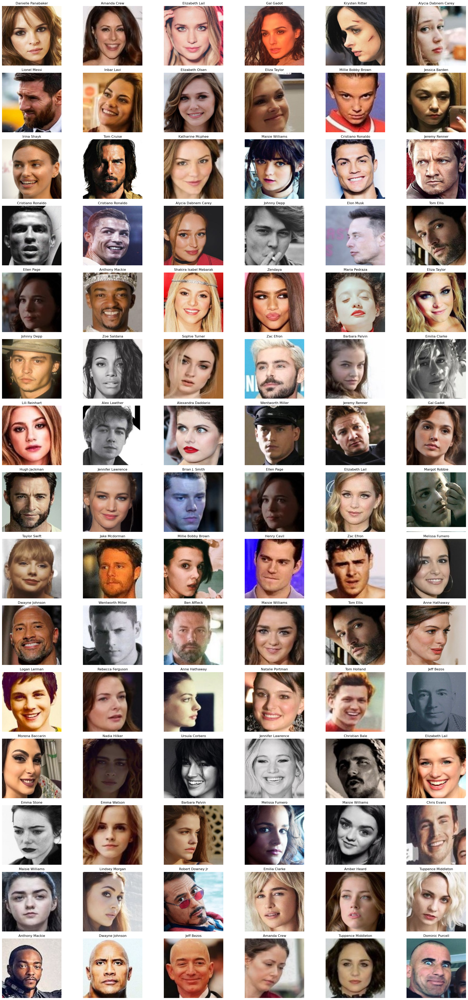

In [8]:
show_data(images = all_images, labels = all_labels)

In [9]:
def load_image(image_path: str, IMG_W: int = IMG_W, IMG_H: int = IMG_H) -> np.ndarray:
    """Load and preprocess image.
    
    Args:
        image_path (str): Path to image file.
        IMG_W (int, optional): Width of image. Defaults to 160.
        IMG_H (int, optional): Height of image. Defaults to 160.
    
    Returns:
        np.ndarray: Preprocessed image.
    """
    
    # Load the image
    image = plt.imread(image_path)
    
    # Resize the image
    image = cv.resize(image, dsize=(IMG_W, IMG_H))
    
    # Convert image type and normalize pixel values
    image = image.astype(np.float32) / 255.0
    
    return image

def image_to_embedding(image: np.ndarray, model) -> np.ndarray:
    """Generate face embedding for image.
    
    Args:
        image (np.ndarray): Image to generate encoding for.
        model : Pretrained face recognition model.
    
    Returns:
        np.ndarray: Face embedding for image.
    """
    
    # Obtain image encoding
    embedding = model.predict(image[np.newaxis,...])
    
    # Normalize bedding using L2 norm.
    embedding /= np.linalg.norm(embedding, ord=2)
    
    # Return embedding
    return embedding
    
def generate_avg_embedding(image_paths: list, model) -> np.ndarray:
    """Generate average face embedding for list of images.
    
    Args:
        image_paths (list): List of paths to image files.
        model : Pretrained face recognition model.
    
    Returns:
        np.ndarray: Average face embedding for images.
    """
    
    # Collect embeddings
    embeddings = np.empty(shape=(len(image_paths), 128))
    
    # Loop over images
    for index, image_path in enumerate(image_paths):
        
        # Load the image
        image = load_image(image_path)
        
        # Generate the embedding
        embedding = image_to_embedding(image, model)
        
        # Store the embedding
        embeddings[index] = embedding
        
    # Compute average embedding
    avg_embedding = np.mean(embeddings, axis=0)
    
    # Clear Output
    cls()
    
    # Return average embedding
    return avg_embedding

In [10]:
# Load model
model = load_model('/kaggle/input/facenet-keras/facenet_keras.h5')

In [11]:
# Select all the file paths : 50 images per person.
filepaths = [np.random.choice(glob(root_path + name + '/*'), size=10) for name in dir_names]

# Create data base
database = {name:generate_avg_embedding(paths, model=model) for paths, name in tqdm(zip(filepaths, person_names), desc="Generating Embeddings")}

Generating Embeddings: 105it [02:51,  1.64s/it]


In [ ]:
# Quick Look at embeddings
# print(database)

In [12]:
def compare_embeddings(embedding_1: np.ndarray, embedding_2: np.ndarray, threshold: float = 0.8) -> int:
    """
    Compares two embeddings and returns 1 if the distance between them is less than the threshold, else 0.

    Args:
    - embedding_1: A 128-dimensional embedding vector.
    - embedding_2: A 128-dimensional embedding vector.
    - threshold: A float value representing the maximum allowed distance between embeddings for them to be considered a match.

    Returns:
    - 1 if the distance between the embeddings is less than the threshold, else 0.
    """

    # Calculate the distance between the embeddings
    embedding_distance = embedding_1 - embedding_2

    # Calculate the L2 norm of the distance vector
    embedding_distance_norm = np.linalg.norm(embedding_distance)

    # Return 1 if the distance is less than the threshold, else 0
    return embedding_distance_norm if embedding_distance_norm < threshold else 0

In [13]:
def recognize_face(image: np.ndarray, database: dict, threshold: float = 1.0, model = model) -> str:
    """
    Given an image, recognize the person in the image using a pre-trained model and a database of known faces.
    
    Args:
        image (np.ndarray): The input image as a numpy array.
        database (dict): A dictionary containing the embeddings of known faces.
        threshold (float): The distance threshold below which two embeddings are considered a match.
        model (keras.Model): A pre-trained Keras model for extracting image embeddings.
        
    Returns:
        str: The name of the recognized person, or "No Match Found" if no match is found.
    """
    
    # Generate embedding for the new image
    image_emb = image_to_embedding(image, model)
    
    # Clear output
    cls()
    
    # Store distances
    distances = []
    names = []
    
    # Loop over database
    for name, embed in database.items():
        
        # Compare the embeddings
        dist = compare_embeddings(embed, image_emb, threshold=threshold)
        
        if dist > 0:
            # Append the score
            distances.append(dist)
            names.append(name)
    
    # Select the min distance
    if distances:
        min_dist = min(distances)
    
        return names[distances.index(min_dist)].title().strip()
    
    return "No Match Found"

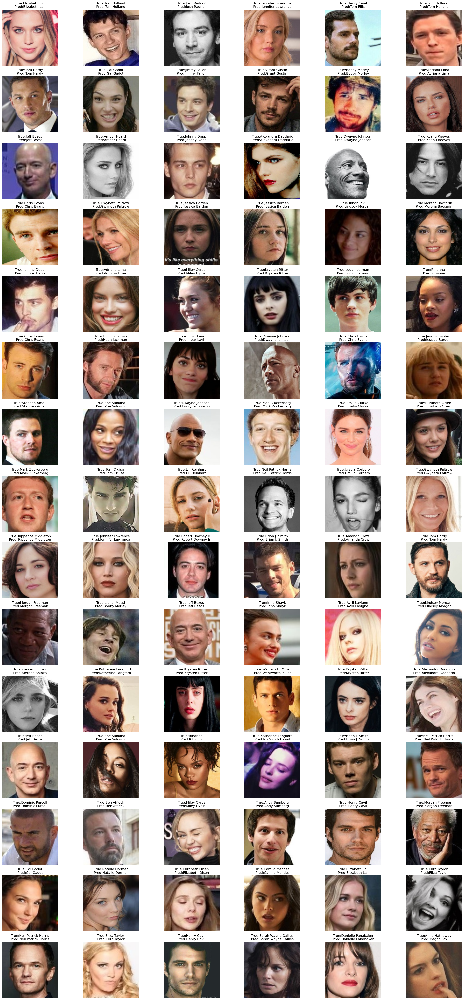

In [15]:
show_data(all_images, all_labels, recog_fn = recognize_face, database = database)

In [ ]:
show_data(all_images, all_labels, recog_fn = recognize_face, database = database)

In [16]:
# Count the number of images
n_images = 50

# Initialize the number of correct predictions
n_correct = 0

# Randomly Select images
indicies = np.random.permutation(n_images)
temp_images = all_images[indicies]
temp_labels = all_labels[indicies]

# Iterate over each image and its corresponding label
for (image, label) in zip(temp_images, temp_labels):
    
    # Extract the true label of the person in the image
    true_label = person_names[int(label)]

    # Use the recognize_face function to predict the label of the person in the image
    pred_label = recognize_face(image, database)

    # If the true label and the predicted label match, increment the number of correct predictions
    if true_label == pred_label:
        n_correct += 1

# Calculate the accuracy of the model
acc = (n_correct / n_images) * 100.0

# Print the accuracy of the model
print(f"Model Accuracy: {acc}%!!!")

Model Accuracy: 90.0%!!!


In [17]:
# Select all the file paths : 50 images per person.
filepaths = [np.random.choice(glob(root_path + name + '/*'), size=50) for name in dir_names]

# Create data base
large_database = {name:generate_avg_embedding(paths, model=model) for paths, name in tqdm(zip(filepaths, person_names), desc="Generating Embeddings")}

Generating Embeddings: 105it [14:13,  8.13s/it]


In [ ]:
show_data(all_images, all_labels, recog_fn = recognize_face, database = large_database)

In [18]:
# Count the number of images
n_images = 100

# Initialize the number of correct predictions
n_correct = 0

# Randomly Select images
indicies = np.random.permutation(n_images)
temp_images = all_images[indicies]
temp_labels = all_labels[indicies]

# Iterate over each image and its corresponding label
for (image, label) in zip(temp_images, temp_labels):
    
    # Extract the true label of the person in the image
    true_label = person_names[int(label)]

    # Use the recognize_face function to predict the label of the person in the image
    pred_label = recognize_face(image, large_database)

    # If the true label and the predicted label match, increment the number of correct predictions
    if true_label == pred_label:
        n_correct += 1

# Calculate the accuracy of the model
acc = (n_correct / n_images) * 100.0

# Print the accuracy of the model
print(f"Model Accuracy: {acc}%!!!")

Model Accuracy: 91.0%!!!


In [ ]:
# Select all the file paths : 50 images per person.
filepaths = [np.random.choice(glob(root_path + name + '/*'), size=25) for name in dir_names]

# Create data base
med_database = {name:generate_avg_embedding(paths, model=model) for paths, name in tqdm(zip(filepaths, person_names), desc="Generating Embeddings")}

In [ ]:
show_data(all_images, all_labels, recog_fn = recognize_face, database = med_database)

In [ ]:
# Count the number of images
n_images = 100

# Initialize the number of correct predictions
n_correct = 0

# Randomly Select images
indicies = np.random.permutation(n_images)
temp_images = all_images[indicies]
temp_labels = all_labels[indicies]

# Iterate over each image and its corresponding label
for (image, label) in zip(temp_images, temp_labels):
    
    # Extract the true label of the person in the image
    true_label = person_names[int(label)]

    # Use the recognize_face function to predict the label of the person in the image
    pred_label = recognize_face(image, med_database)

    # If the true label and the predicted label match, increment the number of correct predictions
    if true_label == pred_label:
        n_correct += 1

# Calculate the accuracy of the model
acc = (n_correct / n_images) * 100.0

# Print the accuracy of the model
print(f"Model Accuracy: {acc}%!!!")